In [1]:
from tsnecuda import TSNE
import pandas as pd
import numpy as np
import pickle
import sys 
import os 
import torch 
%matplotlib inline
import matplotlib.cm as cm
import matplotlib.pyplot as plt 
import seaborn as sns
from tqdm import tqdm_notebook

device =torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
try :
    torch.set_deterministic(True)
except:
    pass
torch.set_printoptions(precision=10)

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/torch/__init__.py:422: UserWarning: torch.set_deterministic is deprecated and will be removed in a future release. Please use torch.use_deterministic_algorithms instead
  "torch.set_deterministic is deprecated and will be removed in a future "


In [2]:
ROOTDIR = "/mindhive/evlab/u/Shared/Greta_Eghbal_manifolds/"
model_identifier = 'NN-tree_nclass=64_nobj=64000_nhier=6_beta=0.000161_sigma=5.0_nfeat=936-train_test-fixed'
train_identifier = "epochs-10_batch-32_lr-0.01_momentum-0.5_init-gaussian_std-1e-06"
analyze_identifier = "mftma-exm_per_class=50-proj=False-rand=True-kappa=1e-08-n_t=300-n_rep=5"
num_subsamples = 100
k = 100
hier_idx = 4
layers = ["layer_0_Input", "layer_1_Linear", "layer_2_Linear", "layer_3_Linear"]
layer = layers[3]
knn_identifier = f"knn_k={k}_subsamples={num_subsamples}" 
pkl_name = f"layer={layer}_hier={hier_idx}_v3.pkl"

SAVEDIR = os.path.join(ROOTDIR, "analyze", knn_identifier, model_identifier, train_identifier)

# tSNE when done on all data

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  This is separate from the ipykernel package so we can avoid doing imports until


0it [00:00, ?it/s]

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


  0%|          | 0/6 [00:00<?, ?it/s]

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:24: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:46: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:65: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:66: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-pack

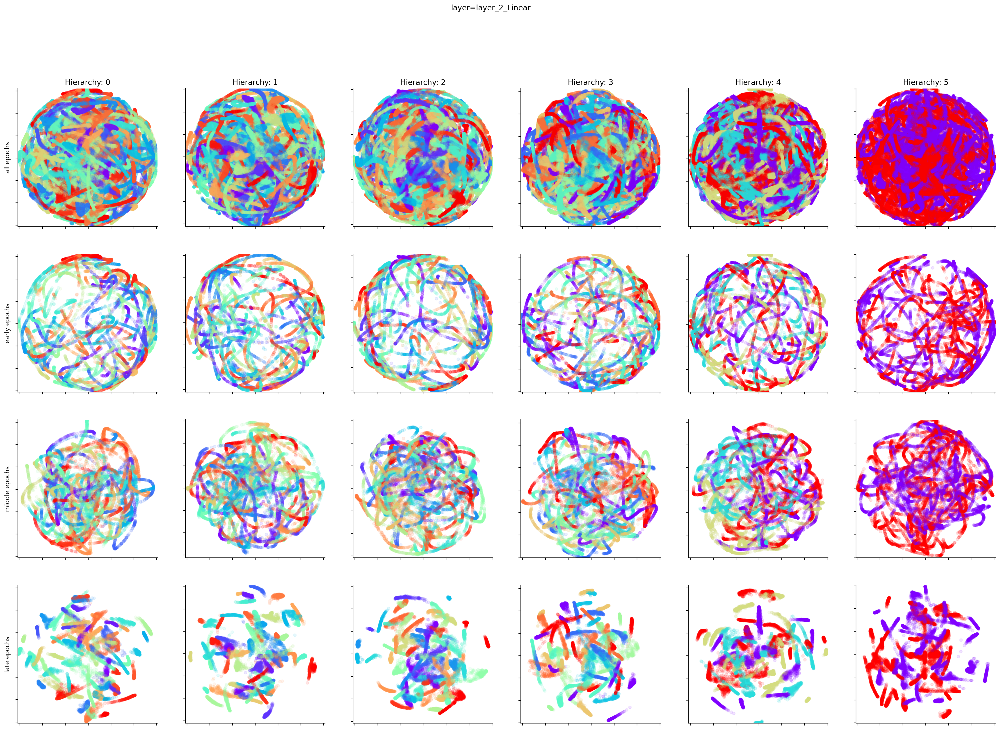

In [4]:
#layers = [ "layer_1_Linear"]#, "layer_2_Linear", "layer_3_Linear"]
layers = ["layer_2_Linear"]#, "layer_3_Linear"]
for idx,layer in tqdm_notebook(enumerate(layers)):
    fig, axes = plt.subplots(4, 6, figsize=(28,28*4/6),dpi=200,frameon=False)
    plt.suptitle(f'layer={layer}')
    for hier_idx in tqdm_notebook(np.arange(6)):
        knn_identifier = f"knn_k={k}_subsamples={num_subsamples}" 
        pkl_name = f"layer={layer}_hier={hier_idx}_v3.pkl"
        data = pickle.load(open(os.path.join(SAVEDIR+"/"+pkl_name),"rb"))
        feat=torch.tensor(data['data'])
        labels=torch.tensor(np.ravel(np.stack(data['targets'])))
        num_colors=labels.unique().shape[0]
        h0=cm.get_cmap('rainbow',num_colors)
        line_cols=np.flipud(h0(np.arange(num_colors)/num_colors))
        all_col=np.asarray([line_cols[x-1,:] for x in labels])
        X_embedded = TSNE(n_components=2, perplexity=30, learning_rate=10).fit_transform(feat)
        # all 
        ax=axes[0,hier_idx]
        ax.scatter(X_embedded[:,0],X_embedded[:,1],c=all_col,s=20,alpha=.1)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.autoscale(enable=True, axis='x', tight=True)
        ax.autoscale(enable=True, axis='y', tight=True)
        ax.set_yticklabels([''])
        ax.set_xticklabels([''])
        xlims=ax.get_xlim()
        ylims=ax.get_ylim()
        if idx==0:
            ax.set_title(f'Hierarchy: {hier_idx}')
        if hier_idx==0:
            ax.set_ylabel(f'all epochs')


        # early 
        ax=axes[1,hier_idx]
        early_samples=np.arange(0,20000).astype('int')
        X_embed_early=X_embedded[early_samples,:]
        labels_early=labels[early_samples]
        all_col_early=all_col[early_samples,:]
        ax.scatter(X_embed_early[:,0],X_embed_early[:,1],c=all_col_early,s=20,alpha=.1)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.autoscale(enable=True, axis='x', tight=True)
        ax.autoscale(enable=True, axis='y', tight=True)
        ax.set_yticklabels([''])
        ax.set_xticklabels([''])
        if hier_idx==0:
            ax.set_ylabel(f'early epochs')

        ax.set_xlim(xlims)
        ax.set_ylim(ylims)
        # middle 
       
        
        ax=axes[2,hier_idx]
        middle_samples=np.arange(40000,60000).astype('int')
        X_embed_middle=X_embedded[middle_samples,:]
        labels_middle=labels[middle_samples]
        all_col_middle=all_col[middle_samples,:]
        ax.scatter(X_embed_middle[:,0],X_embed_middle[:,1],c=all_col_middle,s=20,alpha=.1)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.autoscale(enable=True, axis='x', tight=True)
        ax.autoscale(enable=True, axis='y', tight=True)
        ax.set_yticklabels([''])
        ax.set_xticklabels([''])
        if hier_idx==0:
            ax.set_ylabel(f'middle epochs')
        ax.set_xlim(xlims)
        ax.set_ylim(ylims)
        # late
        ax=axes[3,hier_idx]
        late_samples=np.arange(106000-20000,106000).astype('int')
        X_embed_late=X_embedded[late_samples,:]
        labels_late=labels[late_samples]
        all_col_late=all_col[late_samples,:]
        ax.scatter(X_embed_late[:,0],X_embed_late[:,1],c=all_col_late,s=20,alpha=.1)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.autoscale(enable=True, axis='x', tight=True)
        ax.autoscale(enable=True, axis='y', tight=True)
        ax.set_yticklabels([''])
        ax.set_xticklabels([''])
        if hier_idx==0:
            ax.set_ylabel(f'late epochs')
        ax.set_xlim(xlims)
        ax.set_ylim(ylims)
    #fig.savefig(f"{SAVEDIR}/tSNE_{layer}.pdf",transparent=True)  
    fig.savefig(f"{SAVEDIR}/temporal_tSNE_{layer}.png",transparent=True)  

In [ ]:
layers = [ "layer_3_Linear"]#, "layer_2_Linear", "layer_3_Linear"]

for idx,layer in tqdm_notebook(enumerate(layers)):
    fig, axes = plt.subplots(11, 6, figsize=(28,28*11/6),dpi=200,frameon=False)
    plt.suptitle(f'layer={layer}')
    for hier_idx in tqdm_notebook(np.arange(6)):
        knn_identifier = f"knn_k={k}_subsamples={num_subsamples}" 
        pkl_name = f"layer={layer}_hier={hier_idx}_v3.pkl"
        data = pickle.load(open(os.path.join(SAVEDIR+"/"+pkl_name),"rb"))
        
        feat=torch.tensor(data['data'])
        labels=torch.tensor(np.ravel(np.stack(data['targets'])))
        all_epochs=np.ravel(data['epochs']).astype(int)
        num_colors=labels.unique().shape[0]
        h0=cm.get_cmap('rainbow',num_colors)
        line_cols=np.flipud(h0(np.arange(num_colors)/num_colors))
        all_col=np.asarray([line_cols[x-1,:] for x in labels])
        X_embedded = TSNE(n_components=2, perplexity=30, learning_rate=10).fit_transform(feat)
        # all 
        ax=axes[0,hier_idx]
        ax.scatter(X_embedded[:,0],X_embedded[:,1],c=all_col,s=20,alpha=.1)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.autoscale(enable=True, axis='x', tight=True)
        ax.autoscale(enable=True, axis='y', tight=True)
        ax.set_yticklabels([''])
        ax.set_xticklabels([''])
        xlims=ax.get_xlim()
        ylims=ax.get_ylim()
        if idx==0:
            ax.set_title(f'Hierarchy: {hier_idx}')
        if hier_idx==0:
            ax.set_ylabel(f'all epochs')
        for epoch in range(10):
            epoch_fix=epoch+1
            epoch_idx=np.where(all_epochs==epoch_fix)[0]
        # early 
            ax=axes[epoch+1,hier_idx]

            X_embed_early=X_embedded[epoch_idx,:]
            labels_early=labels[epoch_idx]
            all_col_early=all_col[epoch_idx,:]
            ax.scatter(X_embed_early[:,0],X_embed_early[:,1],c=all_col_early,s=20,alpha=.1)
            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)
            ax.autoscale(enable=True, axis='x', tight=True)
            ax.autoscale(enable=True, axis='y', tight=True)
            ax.set_yticklabels([''])
            ax.set_xticklabels([''])
            if hier_idx==0:
                ax.set_ylabel(f' epoch {epoch_fix}')

            ax.set_xlim(xlims)
            ax.set_ylim(ylims)
       

 
    #fig.savefig(f"{SAVEDIR}/tSNE_{layer}.pdf",transparent=True)  
    #fig.savefig(f"{SAVEDIR}/tSNE_{layer}.png",transparent=True)  

# temporal tsne 

In [ ]:
layers = ["layer_1_Linear","layer_2_Linear", "layer_3_Linear"]

fig, axes = plt.subplots(3, 6, figsize=(28,28*3/6),dpi=200,frameon=False)
for idx,layer in tqdm_notebook(enumerate(layers)):
    for hier_idx in tqdm_notebook(np.arange(6)):
        knn_identifier = f"knn_k={k}_subsamples={num_subsamples}" 
        pkl_name = f"layer={layer}_hier={hier_idx}_v3.pkl"
        data = pickle.load(open(os.path.join(SAVEDIR+"/"+pkl_name),"rb"))
        feat=torch.tensor(data['data'])
        labels=torch.tensor(np.ravel(np.stack(data['targets'])))
        num_colors=labels.shape[0]
        h0=cm.get_cmap('cool',num_colors)
        line_cols=np.flipud(h0(np.arange(num_colors)/num_colors))
        X_embedded = TSNE(n_components=2, perplexity=30, learning_rate=10).fit_transform(feat)
        # all 
        ax=axes[idx,hier_idx]
        ax.scatter(X_embedded[:,0],X_embedded[:,1],c=line_cols,s=20,alpha=.1)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.autoscale(enable=True, axis='x', tight=True)
        ax.autoscale(enable=True, axis='y', tight=True)
        ax.set_yticklabels([''])
        ax.set_xticklabels([''])
        xlims=ax.get_xlim()
        ylims=ax.get_ylim()
        if idx==0:
            ax.set_title(f'Hierarchy: {hier_idx}')
        if hier_idx==0:
            ax.set_ylabel(f'{layer}')


       
     
#fig.savefig(f"{SAVEDIR}/tSNE_time_all_layers.pdf",transparent=True)  
fig.savefig(f"{SAVEDIR}/tSNE_time_all_layers.png",transparent=True)  

# tSNE when its done on each epoch 

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


0it [00:00, ?it/s]

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  import sys


  0%|          | 0/6 [00:00<?, ?it/s]

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:27: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:50: UserWarning: FixedFormatter should only be used together with FixedLocator
/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:51: UserWarning: FixedFormatter should only be used together with FixedLocator


IndexError: index 6 is out of bounds for axis 0 with size 6

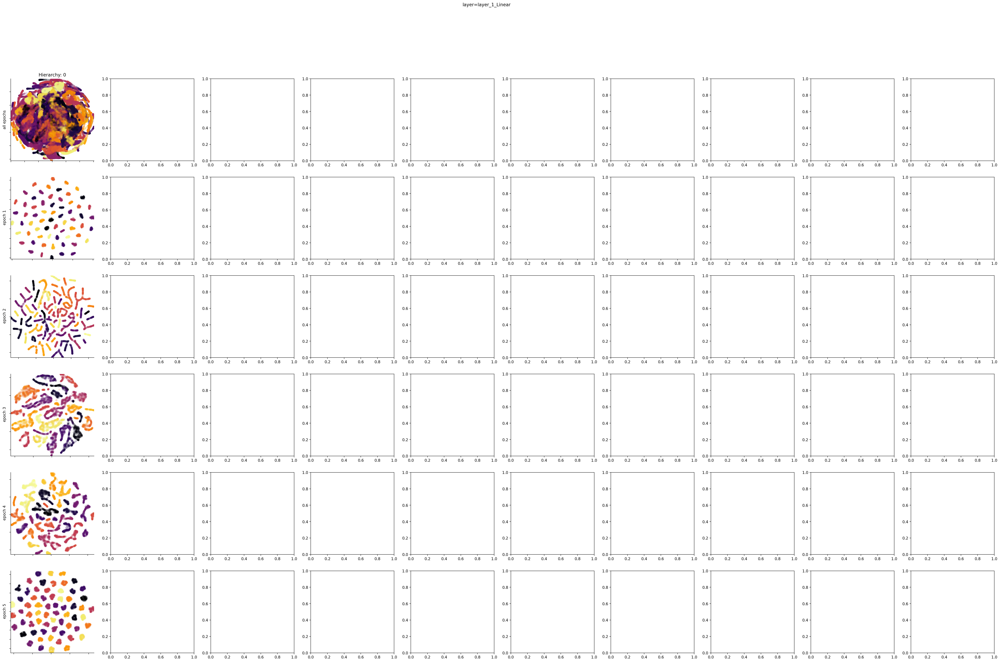

In [4]:
#layers=[ "layer_2_Linear"]
layers = ["layer_1_Linear", "layer_2_Linear", "layer_3_Linear"]

for idx,layer in tqdm_notebook(enumerate(layers)):
    fig, axes = plt.subplots(6, 10, figsize=(28*10/6,28),dpi=200,frameon=False)
    plt.suptitle(f'layer={layer}')
    for hier_idx in tqdm_notebook(np.arange(6)):
        knn_identifier = f"knn_k={k}_subsamples={num_subsamples}" 
        pkl_name = f"layer={layer}_hier={hier_idx}_v3.pkl"
        data = pickle.load(open(os.path.join(SAVEDIR+"/"+pkl_name),"rb"))
        
        feat=torch.tensor(data['data'])
        labels=torch.tensor(np.ravel(np.stack(data['targets'])))
        all_epochs=np.ravel(data['epochs']).astype(int)
        num_colors=labels.unique().shape[0]
        h0=cm.get_cmap('inferno',num_colors+int(np.ceil(num_colors/10)))
        line_cols=np.flipud(h0(np.arange(num_colors)/num_colors))
        all_col=np.asarray([line_cols[x-1,:] for x in labels])
        X_embedded = TSNE(n_components=2, perplexity=30, learning_rate=10).fit_transform(feat)
        # all 
        ax=axes[0,hier_idx]
        ax.scatter(X_embedded[:,0],X_embedded[:,1],c=all_col,s=20,alpha=.1)
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.autoscale(enable=True, axis='x', tight=True)
        ax.autoscale(enable=True, axis='y', tight=True)
        ax.set_yticklabels([''])
        ax.set_xticklabels([''])
        xlims=ax.get_xlim()
        ylims=ax.get_ylim()
        if idx==0:
            ax.set_title(f'Hierarchy: {hier_idx}')
        if hier_idx==0:
            ax.set_ylabel(f'all epochs')
        for epoch in range(10):
            epoch_fix=epoch+1
            epoch_idx=np.where(all_epochs==epoch_fix)[0]
        # early 
            feat_epoch=feat[epoch_idx,:]
            ax=axes[epoch+1,hier_idx]
            X_embed_early = TSNE(n_components=2, perplexity=30, learning_rate=10).fit_transform(feat_epoch)

            labels_early=labels[epoch_idx]
            all_col_early=all_col[epoch_idx,:]
            ax.scatter(X_embed_early[:,0],X_embed_early[:,1],c=all_col_early,s=20,alpha=.1)
            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)
            ax.autoscale(enable=True, axis='x', tight=True)
            ax.autoscale(enable=True, axis='y', tight=True)
            ax.set_yticklabels([''])
            ax.set_xticklabels([''])
            if hier_idx==0:
                ax.set_ylabel(f' epoch {epoch_fix}')

            #ax.set_xlim(xlims)
            #ax.set_ylim(ylims)
       
        fig.savefig(f"{SAVEDIR}/tSNE_epochs_{model_identifier}_{layer}.png",transparent=True)  
 

In [5]:
layers=[ "layer_1_Linear"]
#layers = [ "layer_1_Linear", "layer_2_Linear", "layer_3_Linear"]

for idx,layer in tqdm_notebook(enumerate(layers)):
    fig, axes = plt.subplots(6, 8, figsize=(28*8/6,28),dpi=300,frameon=False)
    plt.suptitle(f'layer={layer}')
    for hier_idx in tqdm_notebook(np.arange(6)):
        knn_identifier = f"knn_k={k}_subsamples={num_subsamples}" 
        pkl_name = f"layer={layer}_hier={hier_idx}_v3.pkl"
        data = pickle.load(open(os.path.join(SAVEDIR+"/"+pkl_name),"rb"))
        
        feat=torch.tensor(data['data'])
        labels=torch.tensor(np.ravel(np.stack(data['targets'])))
        all_epochs=np.ravel(data['epochs']).astype(int)
        num_colors=labels.unique().shape[0]
        h0=cm.get_cmap('inferno',num_colors+int(np.ceil(num_colors/10)))
        line_cols=np.flipud(h0(np.arange(num_colors)/num_colors))
        all_col=np.asarray([line_cols[x-1,:] for x in labels])

        # all 
        for epoch in range(8):
            epoch_fix=epoch+1
            epoch_idx=np.where(all_epochs==epoch_fix)[0]
        # early 
            feat_epoch=feat[epoch_idx,:]
            selections=np.random.choice(feat_epoch.shape[0],2500,replace=False);
            feat_selection=feat_epoch[selections,:]
            ax=axes[5-hier_idx,epoch]
            
            X_embed_early = TSNE(n_components=2, perplexity=30, learning_rate=10).fit_transform(feat_selection)

            labels_early=labels[epoch_idx]
            label_selection=labels_early[selections]
            all_col_early=all_col[epoch_idx,:]
            all_col_selection=all_col_early[selections,:]
            ax.scatter(X_embed_early[:,0],X_embed_early[:,1],c=all_col_selection,s=25,alpha=.7)
            ax.spines['right'].set_visible(False)
            ax.spines['top'].set_visible(False)
            ax.spines['left'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.tick_params(
                    axis='x',          # changes apply to the x-axis
                    which='both',      # both major and minor ticks are affected
                    bottom=False,      # ticks along the bottom edge are off
                    top=False,         # ticks along the top edge are off
                    labelbottom=False) 
            ax.tick_params(
                    axis='y',          # changes apply to the x-axis
                    which='both',      # both major and minor ticks are affected
                    bottom=False,      # ticks along the bottom edge are off
                    top=False,         # ticks along the top edge are off
                    labelbottom=False) 


            #ax.autoscale(enable=True, axis='x', tight=True)
            #ax.autoscale(enable=True, axis='y', tight=True)
            ax.set_xlim((X_embed_early[:,0].min()+.1*X_embed_early[:,0].min(),X_embed_early[:,0].max()+.1*X_embed_early[:,0].max()))
            ax.set_ylim((X_embed_early[:,1].min()+.1*X_embed_early[:,1].min(),X_embed_early[:,1].max()+.1*X_embed_early[:,1].max()))
            ax.set_axis_off()
            #if hier_idx==0:
            #    ax.set_ylabel(f' epoch {epoch_fix}')
            #if idx==0:
            #    ax.set_title(f'Hierarchy: {hier_idx}')

    plt.tight_layout() 
    #plt.suptitle(f"{model_identifier}_{layer}")
    fig.savefig(f"{SAVEDIR}/tSNE_epochs_{model_identifier}_{layer}.png",transparent=True)  
 

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  after removing the cwd from sys.path.


0it [00:00, ?it/s]

/om/user/ehoseini/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  import sys


  0%|          | 0/6 [00:00<?, ?it/s]

In [31]:
selections=np.random.choice(feat_epoch.shape[0],1500,replace=False)


In [25]:
feat_epoch[np.random.choice(10,10,replace=False),:]

torch.Size([10, 624])

In [28]:
feat_epoch.shape

torch.Size([10600, 624])

In [33]:
all_col_early.shape

(10600, 4)